<a href="https://colab.research.google.com/github/superbunny38/Projects/blob/main/PhotoRestoration/Crawlold_datasets_and_prprocess_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**We made two training datasets.**
<br>
- First dataset had in total of 1500 images(500 images in each three folders)<br>
- Second dataset had in total of 150 images(50 images in each three folders)
<br><br>

This demo file shows the process of making the second image dataset 

# Image scraping for Gray-scale Old images
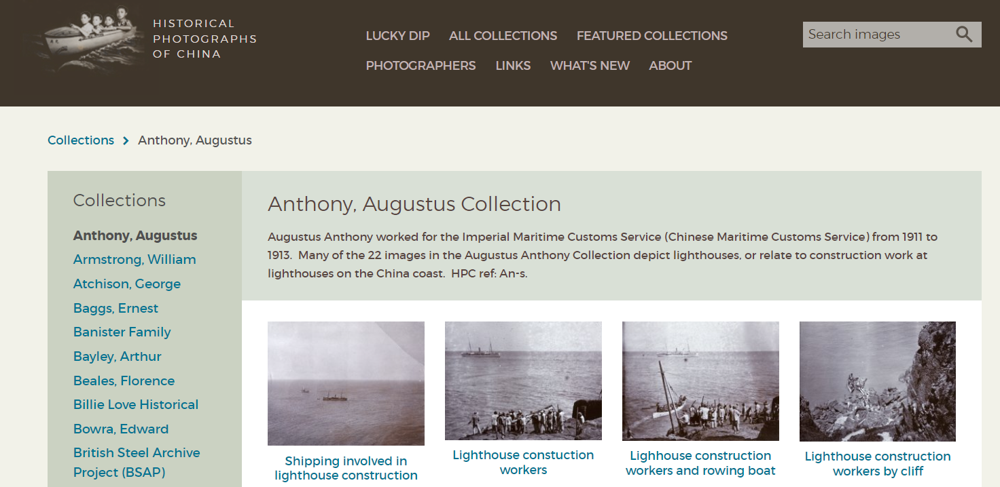

the link of above page: https://www.hpcbristol.net/collections/


By exploring the page above, we noticed that the page url for each author's collection is 'https://www.hpcbristol.net/collections/' + [name of the author]


Therefore, we collected all the names of the authors and made it into a text file.

### list of all the names of photographers

In [ ]:
%%writefile photographers.txt
Anthony, Augustus
Armstrong, William
Atchison, George
Baggs, Ernest
Banister Family
Bayley, Arthur
Beales, Florence
Billie Love Historical
Bowra, Edward
British Steel Archive Project (BSAP)
Cadbury Research Library
Carey, Frederic
Carrall Family
Carstairs, Jamie
Chatterton, Jocelyn
Cooper, William
Cottrell Family
Crellin, Thomas
Crowley, John
Darwent, Charles
Davidson, Francis
Dhoot, Helen
Drew, Edward Bangs
Dudeney, Leo
Edinger, Ernest
Elliott Family
Ephgrave, Jack
Evans, David
Fiddament, Arthur
Fry, John Gurney
Fu Bingchang
Funnell, Martin
Grant, William
Hagger, F.
Harris, Lucy
Hayward Family
Hayward, Tita and Gerry
Hedgeland, Reginald
Henderson, David Marr
Hillier
Hookham, Felix
Hughes, Thomas
Hulme, Oliver
Hutchinson Family
Hutton Potts, George
Johns, Thomas
Johnson, George
Kelsey Family
Kiki de Chaffoy
Klein, Peter
Knight Family
Lang, Archibald
Liu Haiyan
Maxwell Family
Miscellaneous
Mitchell, Eleanor
Montgomery, John
Morrison, Hedda
Morrison, Ian & Rachel
National Archives, Kew
Needham, Joseph
Northup, Lesley
Oswald, John
P.A. Crush Chinese Railway
Palmer, Attwell
Peck, Harold
Phipps, Ann
Pickens Jr., Rev Claude L.
Plant, Cornell
Richard Family
Rosholt, Malcolm
Ross, Cyril
Royal Asiatic Society
Royal Hampshire Regiment
Rue, Henry
Ruxton Family
Sangha, Ranjit Singh
Shaji Massacre, 1925
Sinton, John
Smith, Sydney
Stanfield Family
Steen, James
Stevens, Dennis
Sullivan, John
Swire, G. Warren
Taylor, Edgar
Thompson, John
Tianjin Post Cards
Tocher, Forbes Scott
Trobridge, George
University of Bristol Library
Vacher-Hilditch
Vinden, Gilbert
Wheeler, Charles
Wilkinson, Edward
Williams, Jim
Wyatt-Smith, Stanley
Young, Stewart

Overwriting photographers.txt


show that made the list into a text file in current directory

In [ ]:
!ls

photographers.txt  sample_data


## process the names of authors to make it suitable to put in as url<br>
baseline url + author's name = url for the photo collections of author

In [ ]:
my_file = open("photographers.txt", "r")
name_list = []
for row in my_file:
  "".join(row)
  row = row.replace(",","-")
  row = row.replace(" ","-")
  row = row.replace("--","-")
  row = row.replace("(","")
  row = row.replace(")","")
  row = row.replace("\n","")
  row = row.lower()
  name_list.append(row)

show the pre-processed names

In [ ]:
print(name_list)

['anthony-augustus', 'armstrong-william', 'atchison-george', 'baggs-ernest', 'banister-family', 'bayley-arthur', 'beales-florence', 'billie-love-historical', 'bowra-edward', 'british-steel-archive-project-bsap', 'cadbury-research-library', 'carey-frederic', 'carrall-family', 'carstairs-jamie', 'chatterton-jocelyn', 'cooper-william', 'cottrell-family', 'crellin-thomas', 'crowley-john', 'darwent-charles', 'davidson-francis', 'dhoot-helen', 'drew-edward-bangs', 'dudeney-leo', 'edinger-ernest', 'elliott-family', 'ephgrave-jack', 'evans-david', 'fiddament-arthur', 'fry-john-gurney', 'fu-bingchang', 'funnell-martin', 'grant-william', 'hagger-f.', 'harris-lucy', 'hayward-family', 'hayward-tita-and-gerry', 'hedgeland-reginald', 'henderson-david-marr', 'hillier', 'hookham-felix', 'hughes-thomas', 'hulme-oliver', 'hutchinson-family', 'hutton-potts-george', 'johns-thomas', 'johnson-george', 'kelsey-family', 'kiki-de-chaffoy', 'klein-peter', 'knight-family', 'lang-archibald', 'liu-haiyan', 'maxwel

In [ ]:
len(name_list)#98 photographers

98

make a file to store crawled images

In [ ]:
!mkdir Real_L_old# a folder to store gray-scaled photos

code for downloading images

In [ ]:
from bs4 import *
import requests
import os
def download_images(images, folder_name,total_count):
   
    # initial count is zero
    count = 0
 
    # print total images found in URL
    print(f"Total {len(images)} Image Found!")
 
    # checking if images is not zero
    if len(images) != 0:
        for i, image in enumerate(images):
            # From image tag ,Fetch image Source URL
 
 
            # Here we will use exception handling
 
            # first we will search for "data-srcset" in img tag
            try:
                # In image tag ,searching for "data-srcset"
                image_link = image["data-srcset"]
                 
            # then we will search for "data-src" in img
            # tag and so on..
            except:
                try:
                    # In image tag ,searching for "data-src"
                    image_link = image["data-src"]
                except:
                    try:
                        # In image tag ,searching for "data-fallback-src"
                        image_link = image["data-fallback-src"]
                    except:
                        try:
                            # In image tag ,searching for "src"
                            image_link = image["src"]
 
                        # if no Source URL found
                        except:
                            pass
 
            # After getting Image Source URL
            # We will try to get the content of image
            try:
                r = requests.get(image_link).content
                try:
 
                    # possibility of decode
                    r = str(r, 'utf-8')
 
                except UnicodeDecodeError:
 
                    # After checking above condition, Image Download start
                    with open(f"{folder_name}/images{total_count+i+1}.jpg", "wb+") as f:
                        f.write(r)
 
                    # counting number of image downloaded
                    count += 1
            except:
                pass
 
        # There might be possible, that all
        # images not download
        # if all images download
        if count == len(images):
            print("All Images Downloaded!")
             
        # if all images not download
        else:
            print(f"Total {count} Images Downloaded Out of {len(images)}")
        return count

## crawled 2000 images using BeautifulSoup(a tool for image crawling)

In [ ]:
from urllib.request import urlopen
from bs4 import BeautifulSoup
from six.moves import urllib
import os

from bs4 import *
import requests
import os

count = 1#count the number of images we crawled in total
base_url = "https://www.hpcbristol.net/collections/"
folder = "/content/Real_L_old/"
total_count = 0
for name in name_list:
  tmp_count = 0#number of images crawled in a single page
  print("\n\nAuthor:",name)
  print("in page: 1")
  url = base_url + name
  try:
    r = requests.get(url)
  except:#skips one loop if error arrives
    continue
  soup = BeautifulSoup(r.text, 'html.parser')
  images = soup.findAll('img')
  tmp_count = download_images(images, folder,total_count)
  if tmp_count == None:#don't move to the next page if there is no image crawled from the current page
    continue
  total_count += tmp_count
  page_no = 1
  while(1):#repeats until all the images are crawled by exploring all the pages of the author
    page = "?page="+str(page_no)#page number
    page_no+=1
    another_url = url + page
    try:
      r = requests.get(another_url)
    except:
      break
    print(another_url[-7:],"accessed")
    soup = BeautifulSoup(r.text, 'html.parser')
    images = soup.findAll('img')
    tmp_count = download_images(images, folder, total_count)    
    if tmp_count == None:
      break
    else:
      total_count += tmp_count
  if total_count > 2000:#gather around 2000 images and stop.
    print("\n\nStops gathering... because gathered {} already".format(total_count))
    break#exit for loop
    




Author: anthony-augustus
in page: 1
Total 20 Image Found!
All Images Downloaded!
?page=1 accessed
Total 2 Image Found!
All Images Downloaded!
?page=2 accessed
Total 0 Image Found!


Author: armstrong-william
in page: 1
Total 20 Image Found!
All Images Downloaded!
?page=1 accessed
Total 20 Image Found!
All Images Downloaded!
?page=2 accessed
Total 20 Image Found!
All Images Downloaded!
?page=3 accessed
Total 20 Image Found!
All Images Downloaded!
?page=4 accessed
Total 20 Image Found!
All Images Downloaded!
?page=5 accessed
Total 20 Image Found!
All Images Downloaded!
?page=6 accessed
Total 20 Image Found!
All Images Downloaded!
?page=7 accessed
Total 20 Image Found!
All Images Downloaded!
?page=8 accessed
Total 20 Image Found!
All Images Downloaded!
?page=9 accessed
Total 20 Image Found!
All Images Downloaded!
page=10 accessed
Total 20 Image Found!
All Images Downloaded!
page=11 accessed
Total 20 Image Found!
All Images Downloaded!
page=12 accessed
Total 20 Image Found!
All Images Do

count the number of images crawled

In [ ]:

import os, os.path
path, dirs, files = next(os.walk("/content/Real_L_old"))
file_count = len(files)
print(file_count)

2050


# Preprocessing image

check if the channel of image is gray-scale

In [ ]:
import cv2

im = cv2.imread('/content/Real_L_old/images1.jpg')
print(im.shape)####3 channels means it's RGB file

(178, 225, 3)


function to convert the image to gray-scale image

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def rgb2gray(rgb):
    return np.dot(rgb[...,:3], [0.299, 0.587, 0.144])

make a folder to store converted image

In [ ]:
!mkdir please_input
%cd please_input
!mkdir Real_L_old

/content/please_input


In [ ]:
ls

Real_L_old/


convert images in folder and store them to other directory

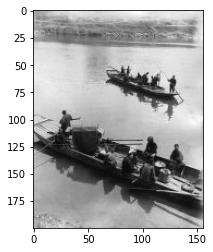

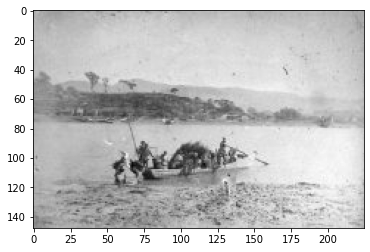

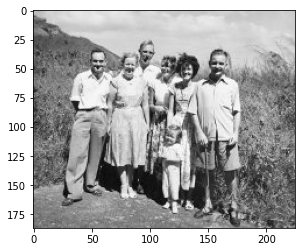

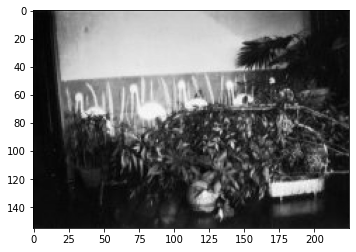

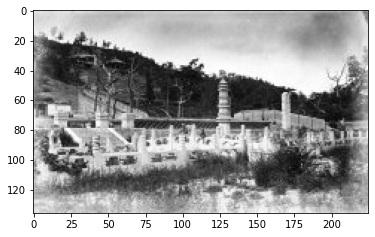

...

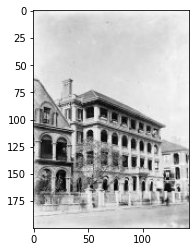

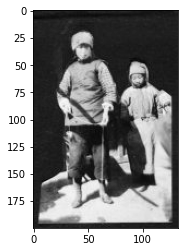

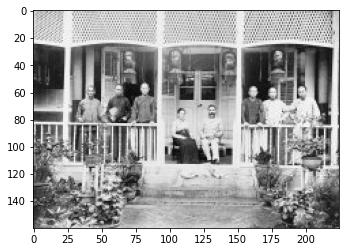

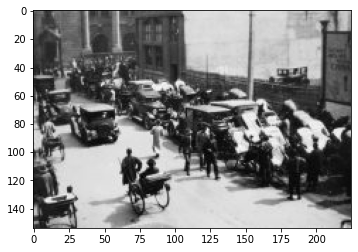

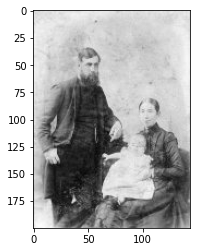

Files Saved


<Figure size 432x288 with 0 Axes>

In [ ]:
#Real_L_old
from matplotlib.pyplot import imshow
from PIL import Image
from IPython.display import Image 

from google.colab.patches import cv2_imshow
count = 0
import cv2
import shutil
import os
import numpy as np
%matplotlib inline

# Define the source and destination path
source = "/content/Real_L_old"
destination = "/content/please_input/Real_L_old"
  
# code to move the files from sub-folder to main folder.
files = os.listdir(source)
for file in files:
    if(count > 52):
      break
    file_name = os.path.join(source, file)
    img = mpimg.imread(file_name)

    gray = rgb2gray(img)#converting to gray-scale image
    plt.imshow(gray, cmap = plt.get_cmap('gray')) 
    plt.show()#show the converted images
    plt.savefig(os.path.join(destination,file)) 
    count+=1  
print("Files Saved")

In [ ]:
#count number of images in JPEGImages
import os, os.path
path, dirs, files = next(os.walk("/content/please_input/Real_L_old"))
file_count = len(files)
print(file_count)

50


# Crawling old RGB images
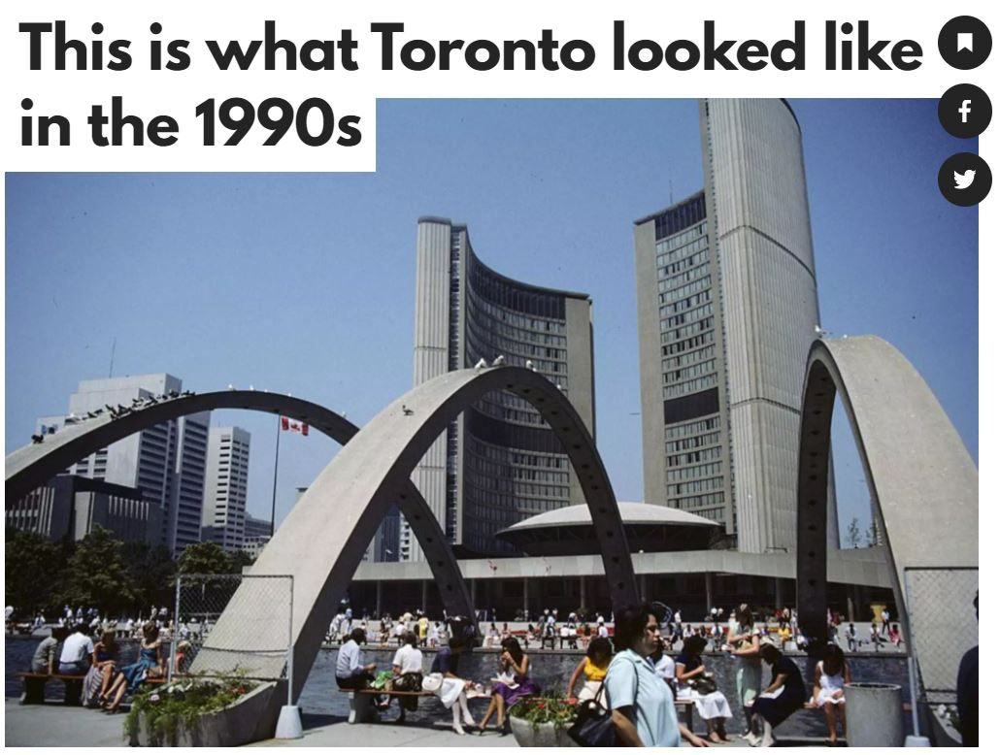

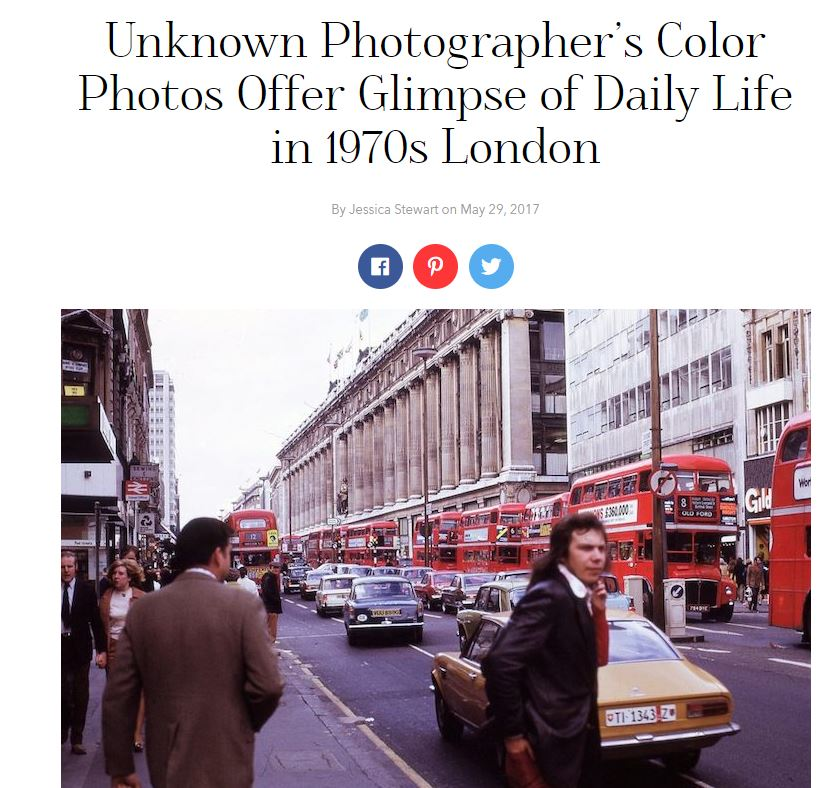

this is a demo crawling for presentation, so we only crawled from two websites.

However, the original code used for crawling rgb images is:
https://colab.research.google.com/drive/1zE2T_uLcTmwLQh2tTqOhwUzDSvqLNKKU?usp=sharing&authuser=2#scrollTo=lnaxK-UV0eW2

make Real_RGB_old folder

In [ ]:
%cd /content
!mkdir Real_RGB_old

/content


Crawling data for Real_RGB_old folder

In [ ]:
url = "https://piximus.net/others/old-america-in-color"
folder = "/content/Real_RGB_old"
try:
    r = requests.get(url)
except:
    exit(0)
soup = BeautifulSoup(r.text, 'html.parser')
images = soup.findAll('img')
tmp_count = download_images(images, folder,total_count)
  

Total 56 Image Found!
All Images Downloaded!


In [ ]:
url = "https://mymodernmet.com/london-photos-1970s/"
folder = "/content/Real_RGB_old"
total_count = 0
try:
    r = requests.get(url)
except:
    exit(0)
soup = BeautifulSoup(r.text, 'html.parser')
images = soup.findAll('img')
tmp_count2 = download_images(images, folder,total_count)

Total 58 Image Found!
Total 57 Images Downloaded Out of 58


In [ ]:
#count number of images in JPEGImages
import os, os.path
path, dirs, files = next(os.walk("/content/Real_RGB_old"))
file_count = len(files)
print(file_count)

113


In [ ]:
%cd please_input
!rm -r Real_RGB_old
!mkdir Real_RGB_old

[Errno 2] No such file or directory: 'please_input'
/content/please_input


In [ ]:
ls

Real_L_old/  Real_RGB_old/





 /content/Real_RGB_old/images23.jpg
1th


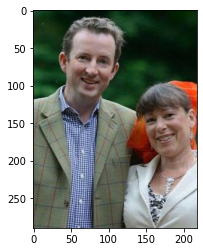




 /content/Real_RGB_old/images2100.jpg
2th


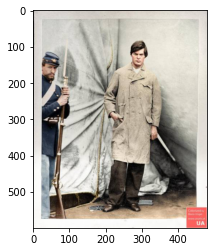




 /content/Real_RGB_old/images2054.jpg
3th


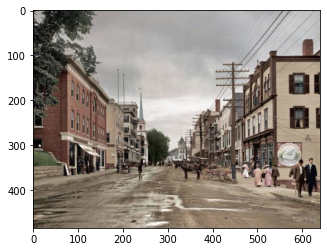




 /content/Real_RGB_old/images2080.jpg
4th


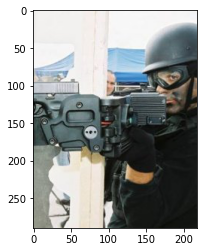




 /content/Real_RGB_old/images2094.jpg
5th


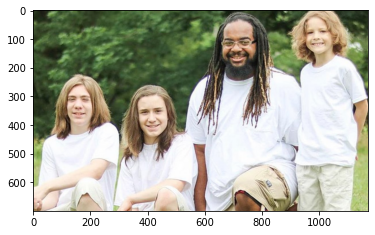




 /content/Real_RGB_old/images6.jpg
6th


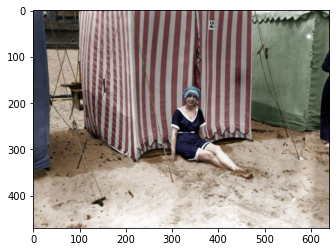




 /content/Real_RGB_old/images2064.jpg
7th


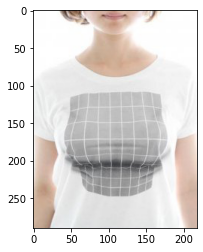




 /content/Real_RGB_old/images2105.jpg
8th


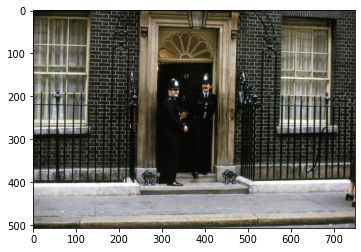




 /content/Real_RGB_old/images13.jpg
9th


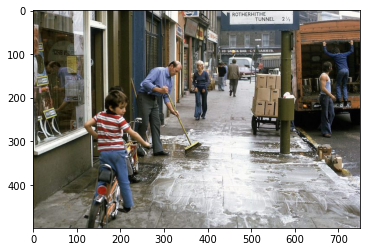




 /content/Real_RGB_old/images37.jpg
10th


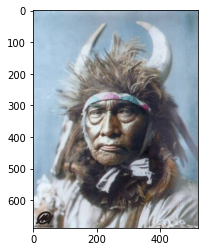




 /content/Real_RGB_old/images2052.jpg
11th


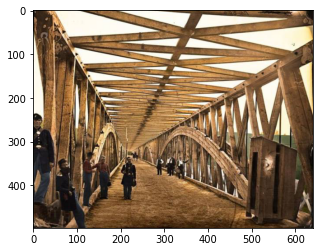




 /content/Real_RGB_old/images2063.jpg
12th


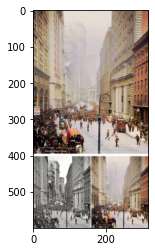




 /content/Real_RGB_old/images2060.jpg
13th


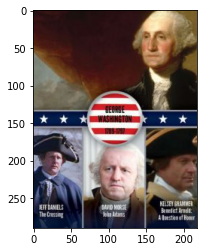




 /content/Real_RGB_old/images2096.jpg
14th


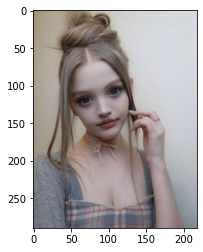




 /content/Real_RGB_old/images2102.jpg
15th


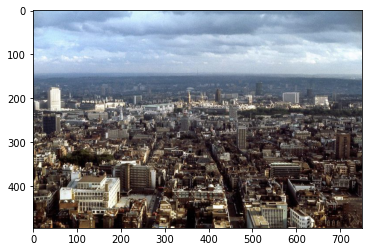




 /content/Real_RGB_old/images25.jpg
16th


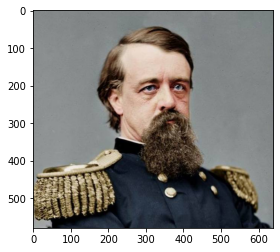




 /content/Real_RGB_old/images2076.jpg
17th


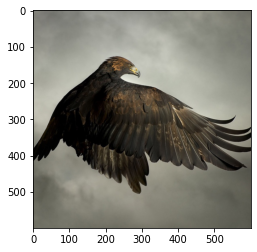




 /content/Real_RGB_old/images48.jpg
18th


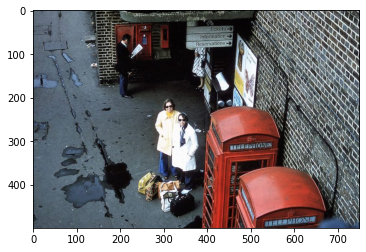




 /content/Real_RGB_old/images30.jpg
19th


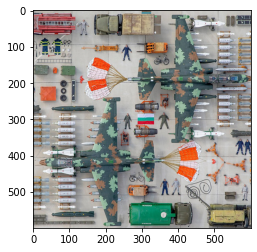




 /content/Real_RGB_old/images51.jpg
20th


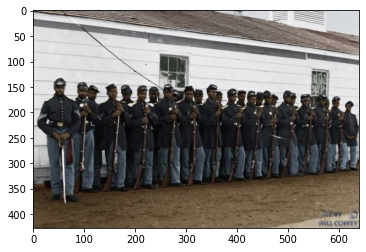




 /content/Real_RGB_old/images2074.jpg
21th


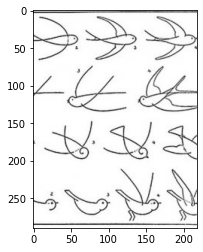




 /content/Real_RGB_old/images2099.jpg
22th


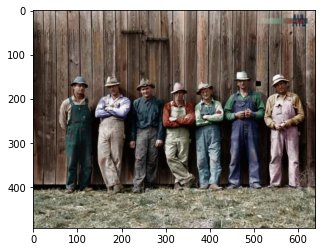




 /content/Real_RGB_old/images2078.jpg
23th


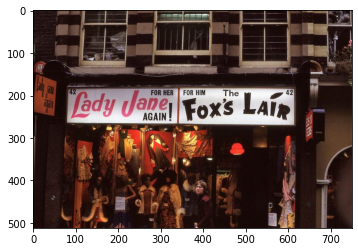




 /content/Real_RGB_old/images39.jpg
24th


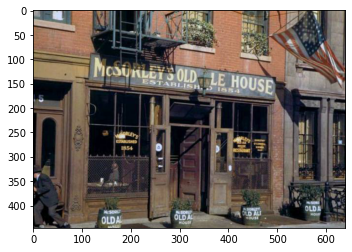




 /content/Real_RGB_old/images2072.jpg
25th


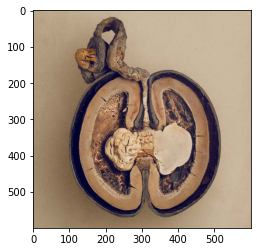




 /content/Real_RGB_old/images49.jpg
26th


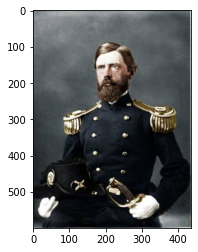




 /content/Real_RGB_old/images2055.jpg
27th


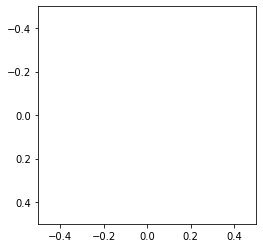




 /content/Real_RGB_old/images1.jpg
28th


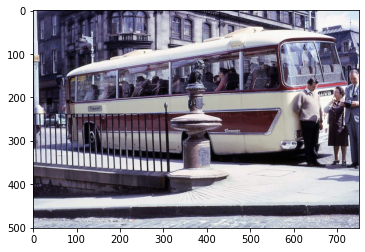




 /content/Real_RGB_old/images19.jpg
29th


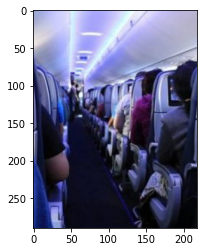




 /content/Real_RGB_old/images2095.jpg
30th


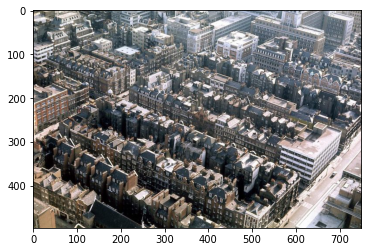




 /content/Real_RGB_old/images29.jpg
31th


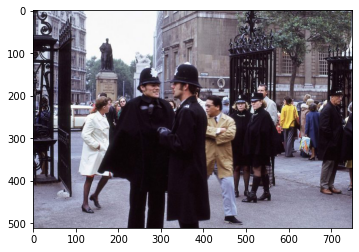




 /content/Real_RGB_old/images20.jpg
32th


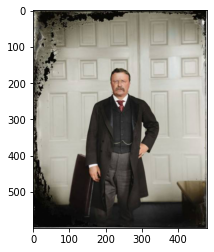




 /content/Real_RGB_old/images2075.jpg
33th


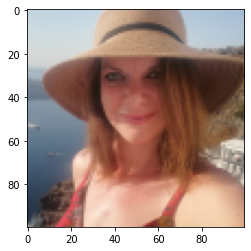




 /content/Real_RGB_old/images40.jpg
34th


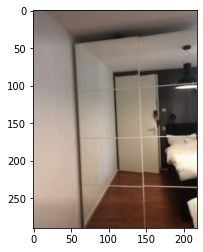




 /content/Real_RGB_old/images2092.jpg
35th


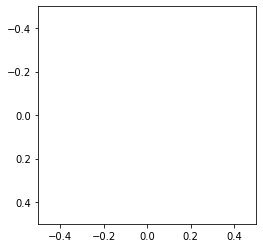




 /content/Real_RGB_old/images2051.jpg
36th


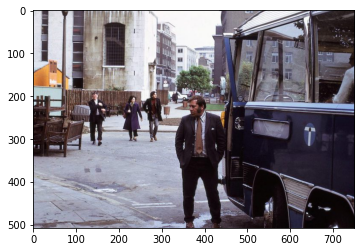




 /content/Real_RGB_old/images22.jpg
37th


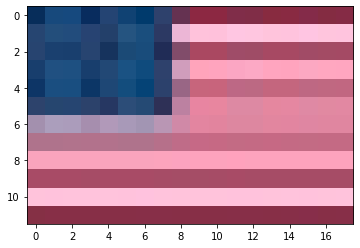




 /content/Real_RGB_old/images8.jpg
38th


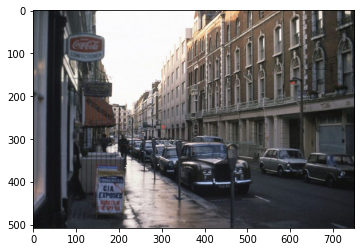




 /content/Real_RGB_old/images21.jpg
39th


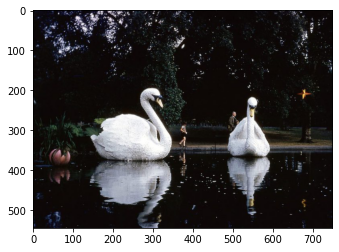




 /content/Real_RGB_old/images32.jpg
40th


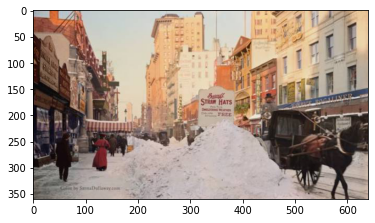




 /content/Real_RGB_old/images2079.jpg
41th


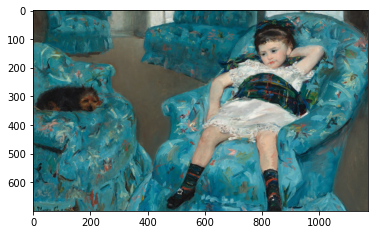




 /content/Real_RGB_old/images5.jpg
42th


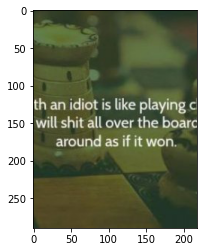




 /content/Real_RGB_old/images2106.jpg
43th


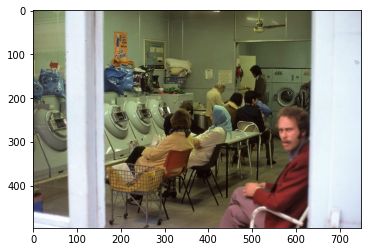




 /content/Real_RGB_old/images33.jpg
44th


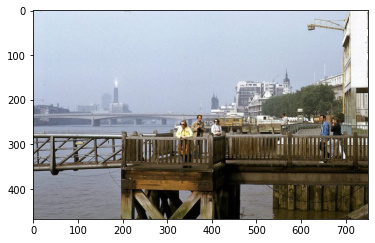




 /content/Real_RGB_old/images15.jpg
45th


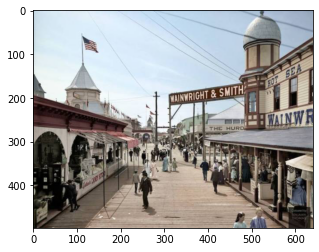




 /content/Real_RGB_old/images2058.jpg
46th


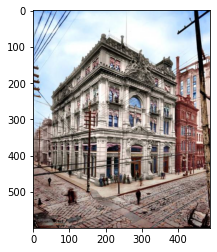




 /content/Real_RGB_old/images2066.jpg
47th


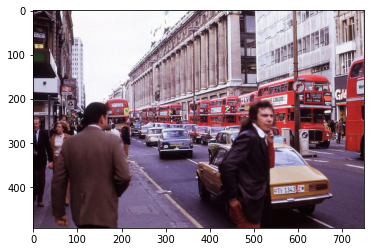




 /content/Real_RGB_old/images10.jpg
48th


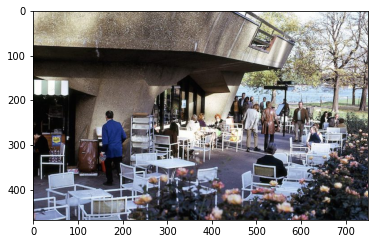




 /content/Real_RGB_old/images26.jpg
49th


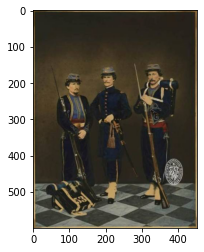




 /content/Real_RGB_old/images2059.jpg
50th


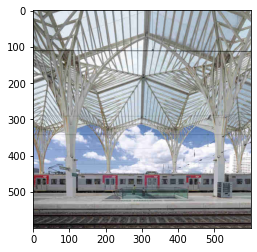




 /content/Real_RGB_old/images54.jpg
51th


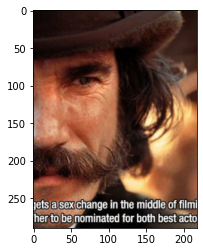




 /content/Real_RGB_old/images2103.jpg
52th


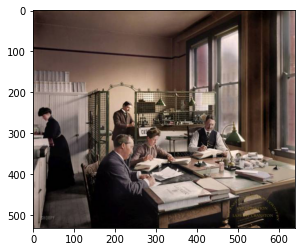




 /content/Real_RGB_old/images2065.jpg
53th


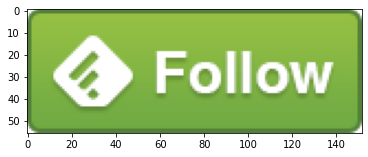




 /content/Real_RGB_old/images3.jpg
54th


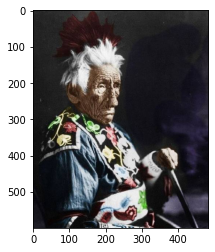




 /content/Real_RGB_old/images2086.jpg
55th


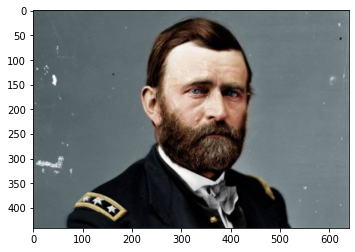




 /content/Real_RGB_old/images2073.jpg
56th


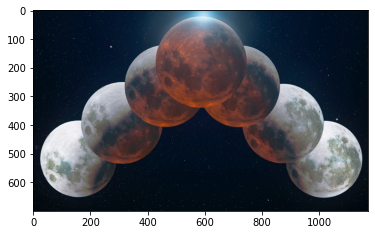




 /content/Real_RGB_old/images7.jpg
57th


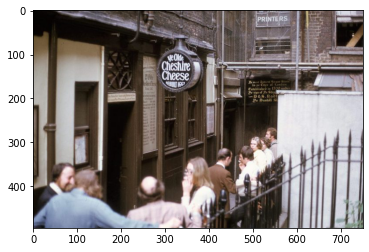




 /content/Real_RGB_old/images36.jpg
58th


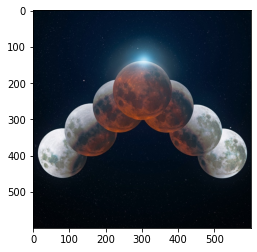




 /content/Real_RGB_old/images47.jpg
59th


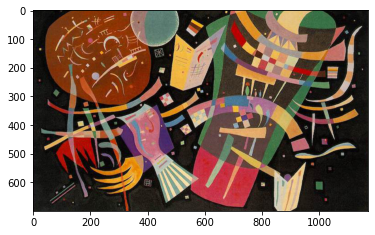




 /content/Real_RGB_old/images4.jpg
60th


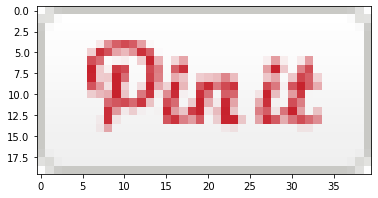




 /content/Real_RGB_old/images2089.jpg
61th


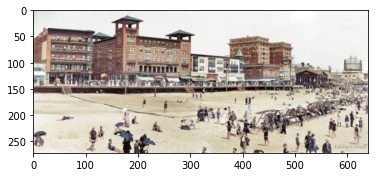




 /content/Real_RGB_old/images2082.jpg
62th


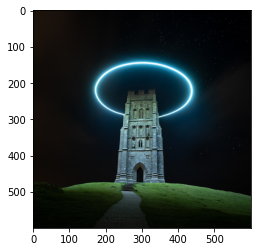




 /content/Real_RGB_old/images55.jpg
63th


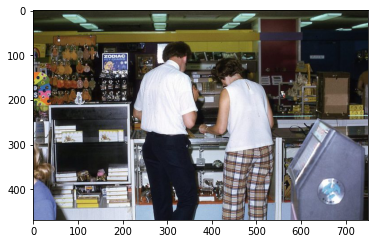




 /content/Real_RGB_old/images14.jpg
64th


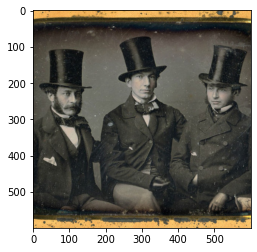




 /content/Real_RGB_old/images58.jpg
65th


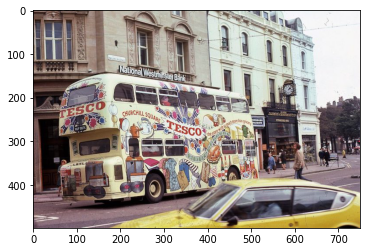




 /content/Real_RGB_old/images23.jpg
66th


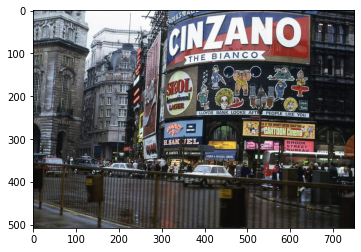




 /content/Real_RGB_old/images12.jpg
67th


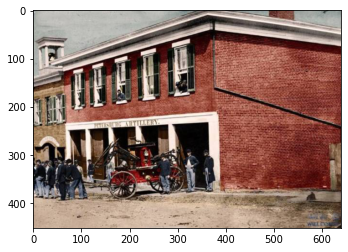




 /content/Real_RGB_old/images2062.jpg
68th


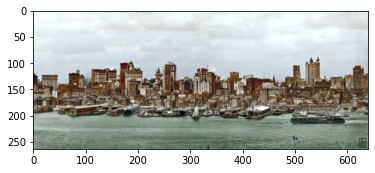




 /content/Real_RGB_old/images2056.jpg
69th


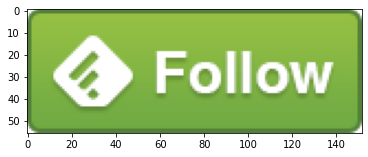




 /content/Real_RGB_old/images9.jpg
70th


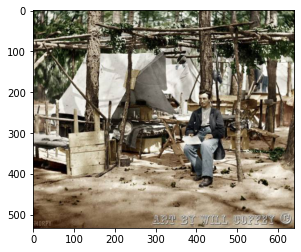




 /content/Real_RGB_old/images2077.jpg
71th


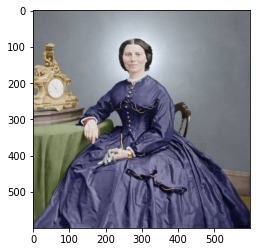




 /content/Real_RGB_old/images2061.jpg
72th


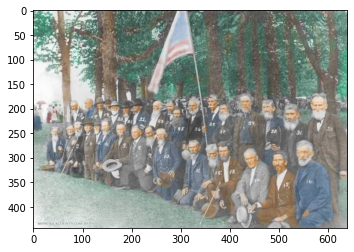




 /content/Real_RGB_old/images2057.jpg
73th


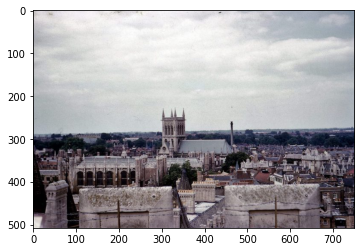




 /content/Real_RGB_old/images31.jpg
74th


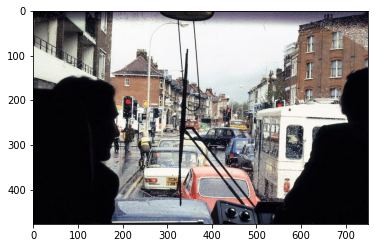




 /content/Real_RGB_old/images17.jpg
75th


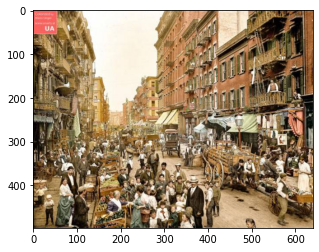

Files Saved


<Figure size 432x288 with 0 Axes>

In [ ]:
#Real_L_old
from matplotlib.pyplot import imshow
from PIL import Image
from IPython.display import Image 

from google.colab.patches import cv2_imshow
count = 1
import cv2
import shutil
import os
import numpy as np
%matplotlib inline

# Define the source and destination path
source = "/content/Real_RGB_old"
destination = "/content/please_input/Real_RGB_old"
  
# code to move the files from sub-folder to main folder.
files = os.listdir(source)
for file in files:
    if(count > 75):
      break
    print("\n\n\n",file_name)
    print("{}th".format(count))
    file_name = os.path.join(source, file)
    img = mpimg.imread(file_name)
    plt.imshow(img) 
    
    plt.show()
    plt.savefig(os.path.join(destination,file)) 
    count+=1  
print("Files Saved")

delete wrong image files(ex. advertisement pictures) by name manually

In [ ]:
#count number of images in JPEGImages
import os, os.path
path, dirs, files = next(os.walk("/content/please_input/Real_RGB_old"))
file_count = len(files)
print(file_count)

50


In [ ]:
#count number of images in JPEGImages
import os, os.path
path, dirs, files = next(os.walk("/content/please_input/Real_L_old"))
file_count = len(files)
print(file_count)

50


In [ ]:
%cd /content/please_input

/content/please_input


In [ ]:
!mkdir VOC_RGB_JPEGImages


In [ ]:
#count number of images in JPEGImages
import os, os.path
path, dirs, files = next(os.walk("/content/new_inputs/new_inputs/VOC_RGB_JPEGImages"))
file_count = len(files)
print(file_count)

556


In [ ]:
%cd /content/please_input
!rm -r VOC_RGB_JPEGImages
!mkdir VOC_RGB_JPEGImages

/content/please_input


# Images of VOC dataset




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002485.jpg
1th


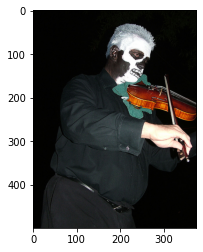




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002140.jpg
2th


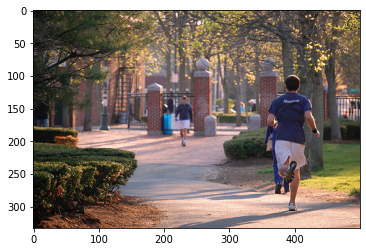




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001616.jpg
3th


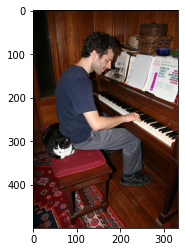




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003761.jpg
4th


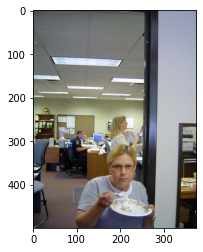




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003309.jpg
5th


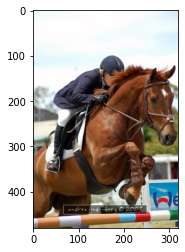




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001634.jpg
6th


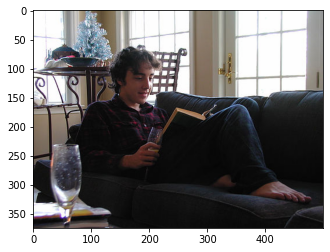




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002863.jpg
7th


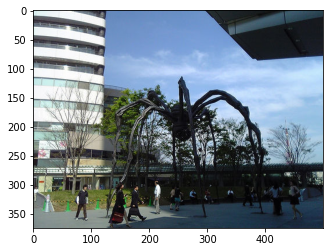




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003797.jpg
8th


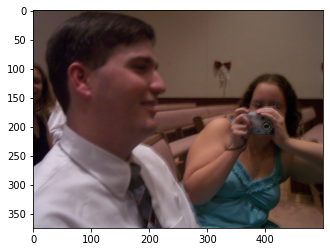




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002368.jpg
9th


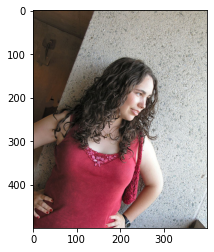




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001046.jpg
10th


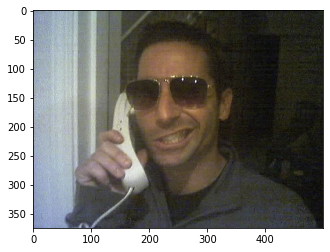




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001662.jpg
11th


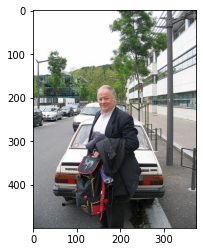




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_000863.jpg
12th


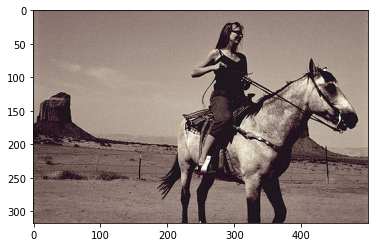




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002843.jpg
13th


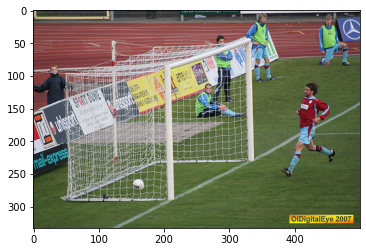




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001666.jpg
14th


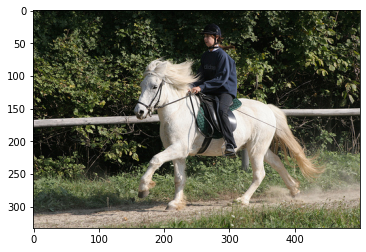




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003108.jpg
15th


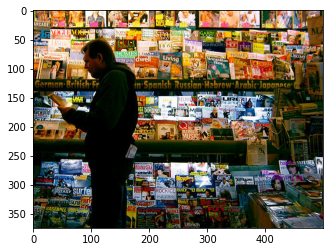




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001316.jpg
16th


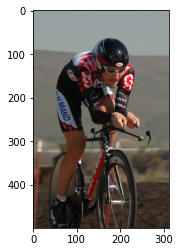




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001792.jpg
17th


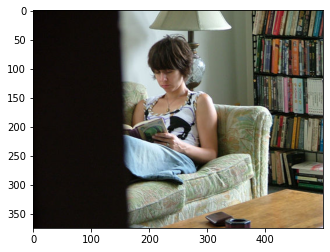




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_004048.jpg
18th


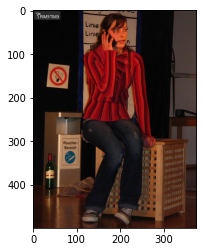




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003922.jpg
19th


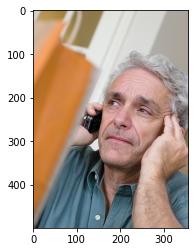




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003386.jpg
20th


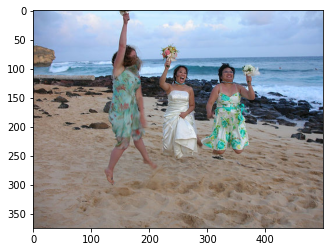




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002340.jpg
21th


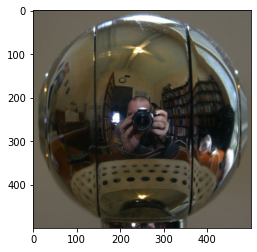




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001034.jpg
22th


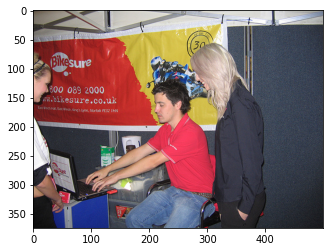




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_004099.jpg
23th


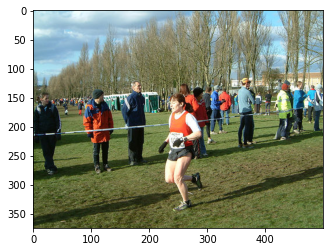




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_004111.jpg
24th


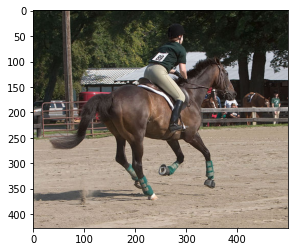




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001382.jpg
25th


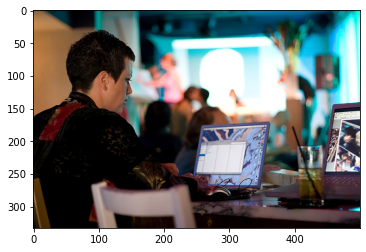




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003644.jpg
26th


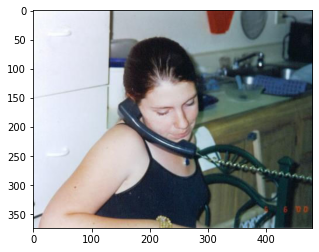




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002924.jpg
27th


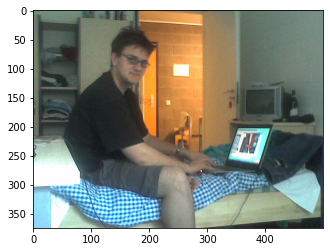




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_004177.jpg
28th


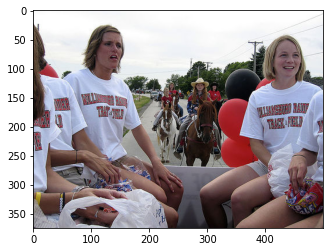




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002339.jpg
29th


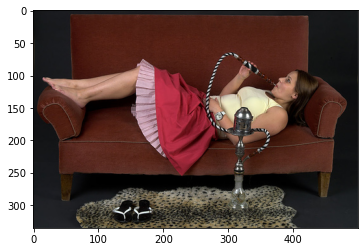




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_004147.jpg
30th


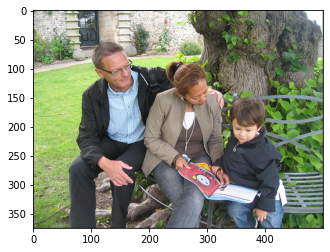




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002133.jpg
31th


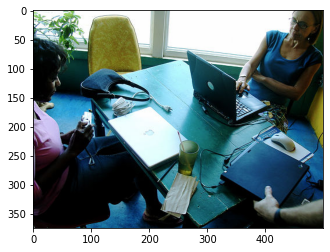




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001784.jpg
32th


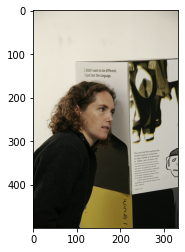




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003715.jpg
33th


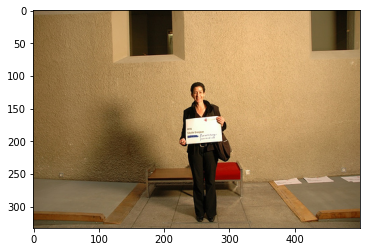




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002992.jpg
34th


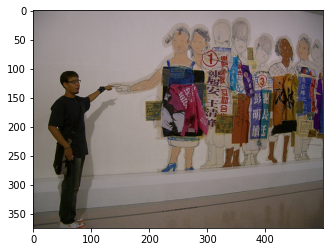




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_004306.jpg
35th


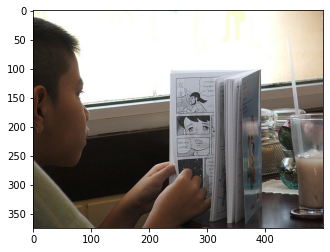




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001295.jpg
36th


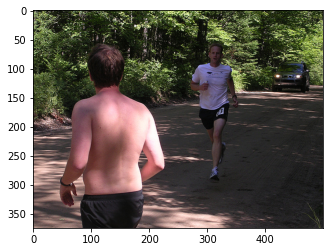




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002301.jpg
37th


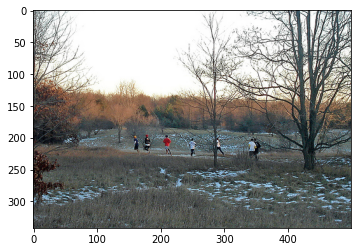




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001405.jpg
38th


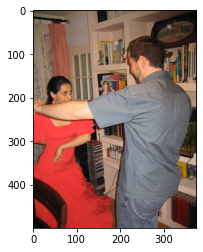




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_000692.jpg
39th


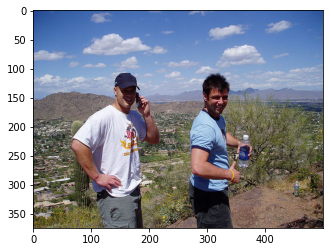




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003991.jpg
40th


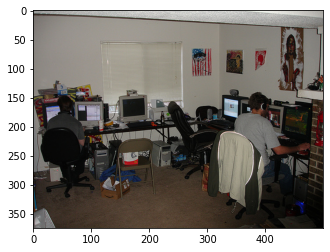




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_000618.jpg
41th


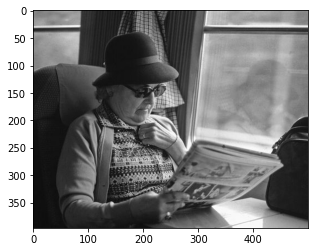




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003199.jpg
42th


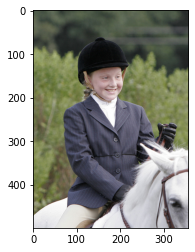




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_000658.jpg
43th


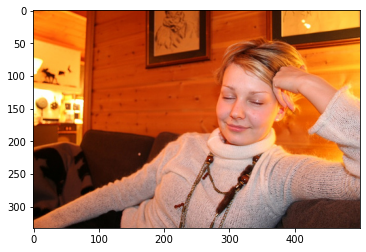




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003317.jpg
44th


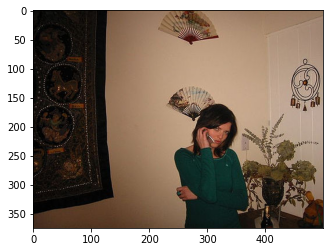




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002196.jpg
45th


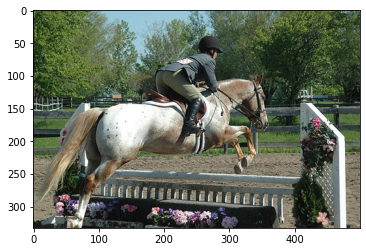




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_000475.jpg
46th


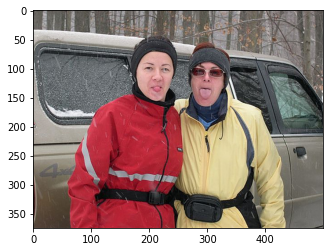




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_000978.jpg
47th


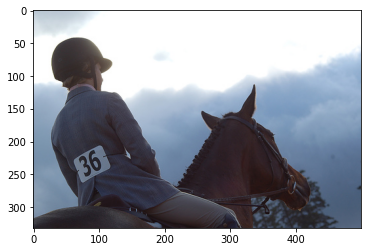




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_003225.jpg
48th


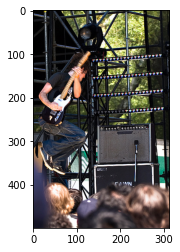




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_001570.jpg
49th


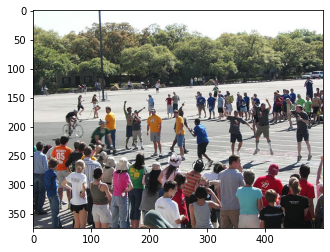




 /content/new_inputs/new_inputs/VOC_RGB_JPEGImages/2012_002306.jpg
50th


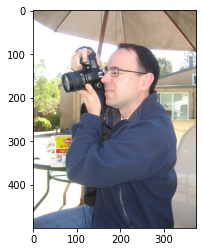

Files Saved


<Figure size 432x288 with 0 Axes>

In [ ]:
#Real_L_old
from matplotlib.pyplot import imshow
from PIL import Image
from IPython.display import Image 

from google.colab.patches import cv2_imshow
count = 1
import cv2
import shutil
import os
import numpy as np
%matplotlib inline

# Define the source and destination path
source = "/content/new_inputs/new_inputs/VOC_RGB_JPEGImages"
destination = "/content/please_input/VOC_RGB_JPEGImages"
  
# code to move the files from sub-folder to main folder.
files = os.listdir(source)
for file in files:
    if(count > 50):
      break
    print("\n\n\n",file_name)
    print("{}th".format(count))
    file_name = os.path.join(source, file)
    img = mpimg.imread(file_name)
    plt.imshow(img) 
    
    plt.show()
    plt.savefig(os.path.join(destination,file)) 
    count+=1  
print("Files Saved")

# zip the folder containing crawled datasets

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/

/content


In [ ]:
!zip -r input.zip /content/please_input

  adding: content/please_input/ (stored 0%)
  adding: content/please_input/Real_RGB_old/ (stored 0%)
  adding: content/please_input/Real_RGB_old/images2100.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images2054.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images2080.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images2094.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images6.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images2105.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images13.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images37.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images2052.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images2102.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images25.jpg (deflated 83%)
  adding: content/please_input/Real_RGB_old/images2076.jpg (deflated 83%)
  adding: content/pl

download it from colab to this computer, so that we can use the image datasets in other colab files

In [ ]:
from google.colab import files
files.download("input.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>